**Подключение библиотек и скриптов**

In [27]:
import numpy as np
import pandas as pd

In [49]:
# !pip install shap

In [1]:
#  !pip install pandas-profiling

  Running setup.py bdist_wheel for pandas-profiling: started
  Running setup.py bdist_wheel for pandas-profiling: finished with status 'done'
  Stored in directory: C:\Users\LMAXL\AppData\Local\pip\Cache\wheels\ce\c7\f1\dbfef4848ebb048cb1d4a22d1ed0c62d8ff2523747235e19fe
  Running setup.py bdist_wheel for htmlmin: started
  Running setup.py bdist_wheel for htmlmin: finished with status 'done'
  Stored in directory: C:\Users\LMAXL\AppData\Local\pip\Cache\wheels\43\07\ac\7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
  Running setup.py bdist_wheel for confuse: started
  Running setup.py bdist_wheel for confuse: finished with status 'done'
  Stored in directory: C:\Users\LMAXL\AppData\Local\pip\Cache\wheels\b0\b2\96\2074eee7dbf7b7df69d004c9b6ac4e32dad04fb7666cf943bd
Successfully built pandas-profiling htmlmin confuse


In [2]:
import pandas_profiling

**Пути к директориям и файлам**

In [2]:
# input
DATASET_PATH = 'course_project_train.csv'

# output
PREP_DATASET_PATH = 'course_project_train_prep.csv'

### Загрузка данных<a class="anchor" id="load_data"></a>

In [29]:
df = pd.read_csv(DATASET_PATH)
df.head()

,Home Ownership,Annual Income,Years in current job,Tax Liens,Number of Open Accounts,Years of Credit History,Maximum Open Credit,Number of Credit Problems,Months since last delinquent,Bankruptcies,Purpose,Term,Current Loan Amount,Current Credit Balance,Monthly Debt,Credit Score,Credit Default
0,Own Home,482087.0,NaN,0.0,11.0,26.3,685960.0,1.0,NaN,1.0,debt consolidation,Short Term,99999999.0,47386.0,7914.0,749.0,0
1,Own Home,1025487.0,10+ years,0.0,15.0,15.3,1181730.0,0.0,NaN,0.0,debt consolidation,Long Term,264968.0,394972.0,18373.0,737.0,1
2,Home Mortgage,751412.0,8 years,0.0,11.0,35.0,1182434.0,0.0,NaN,0.0,debt consolidation,Short Term,99999999.0,308389.0,13651.0,742.0,0
3,Own Home,805068.0,6 years,0.0,8.0,22.5,147400.0,1.0,NaN,1.0,debt consolidation,Short Term,121396.0,95855.0,11338.0,694.0,0
4,Rent,776264.0,8 years,0.0,13.0,13.6,385836.0,1.0,NaN,0.0,debt consolidation,Short Term,125840.0,93309.0,7180.0,719.0,0


In [4]:
df.shape

(7500, 17)

In [5]:
df.iloc[0]

Home Ownership                            Own Home
Annual Income                               482087
Years in current job                           NaN
Tax Liens                                        0
Number of Open Accounts                         11
Years of Credit History                       26.3
Maximum Open Credit                         685960
Number of Credit Problems                        1
Months since last delinquent                   NaN
Bankruptcies                                     1
Purpose                         debt consolidation
Term                                    Short Term
Current Loan Amount                          1e+08
Current Credit Balance                       47386
Monthly Debt                                  7914
Credit Score                                   749
Credit Default                                   0
Name: 0, dtype: object

In [30]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7500 entries, 0 to 7499
Data columns (total 17 columns):
Home Ownership                  7500 non-null object
Annual Income                   5943 non-null float64
Years in current job            7129 non-null object
Tax Liens                       7500 non-null float64
Number of Open Accounts         7500 non-null float64
Years of Credit History         7500 non-null float64
Maximum Open Credit             7500 non-null float64
Number of Credit Problems       7500 non-null float64
Months since last delinquent    3419 non-null float64
Bankruptcies                    7486 non-null float64
Purpose                         7500 non-null object
Term                            7500 non-null object
Current Loan Amount             7500 non-null float64
Current Credit Balance          7500 non-null float64
Monthly Debt                    7500 non-null float64
Credit Score                    5943 non-null float64
Credit Default                  7

In [31]:
for c in df.columns:
    print (c, ': Total unique = ', len(df[c].unique()), df[c].unique(), '\n')

Home Ownership : Total unique =  4 ['Own Home' 'Home Mortgage' 'Rent' 'Have Mortgage'] 

Annual Income : Total unique =  5479 [ 482087. 1025487.  751412. ... 2833185. 1257610.  402192.] 

Years in current job : Total unique =  12 [nan '10+ years' '8 years' '6 years' '7 years' '5 years' '1 year'
 '< 1 year' '4 years' '3 years' '2 years' '9 years'] 

Tax Liens : Total unique =  8 [0. 3. 1. 2. 4. 6. 5. 7.] 

Number of Open Accounts : Total unique =  39 [11. 15.  8. 13. 12.  9. 17. 10.  7.  6. 14.  3. 20. 19. 22. 18.  5. 16.
  4.  2. 23. 24. 21. 25. 32. 33. 31. 30. 29. 28. 26. 27. 43. 41. 34. 38.
 35. 37. 42.] 

Years of Credit History : Total unique =  408 [26.3 15.3 35.  22.5 13.6 14.6 20.3 12.  15.7 24.6 11.5 17.6 14.  17.7
 18.4 17.8 28.5 29.  12.5 26.5 34.4 28.3 14.8 25.  29.8 15.8 14.5 19.5
 18.6 20.5 21.  10.2 31.4 18.   7.6 23.7 15.  10.9  9.4 15.4 21.4 27.3
 18.7 17.  22.2 10.4  9.5 19.2 16.3 21.2 10.7 17.3 12.9 16.  16.6 15.6
 13.3 11.3 17.5 13.1 12.1 32.5 12.7  9.  18.1 36.8 16.

In [32]:
pandas_profiling.ProfileReport(df)

### Приведение типов<a class="anchor" id="cast"></a>

In [33]:
df.loc[df['Home_Ownership']=='Have Mortgage']

,Home_Ownership,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,Purpose,Term,Current_Loan_Amount,Current_Credit_Balance,Monthly_Debt,Credit_Score,Credit_Default
44,Have Mortgage,1334256.0,10+ years,0.0,17.0,15.4,380052288.0,1.0,35.0,0.0,take a trip,Short Term,33110.0,656450.0,34357.0,729.0,0
81,Have Mortgage,1112298.0,< 1 year,0.0,7.0,9.0,81598.0,0.0,NaN,0.0,take a trip,Short Term,128788.0,42921.0,15906.0,704.0,1
130,Have Mortgage,NaN,10+ years,0.0,8.0,33.6,651794.0,0.0,13.0,0.0,take a trip,Short Term,108218.0,401356.0,15390.0,NaN,0
702,Have Mortgage,964136.0,8 years,0.0,6.0,17.2,85624.0,0.0,33.0,0.0,take a trip,Short Term,162228.0,67279.0,4789.0,689.0,0
747,Have Mortgage,1112640.0,2 years,0.0,12.0,22.0,95150.0,0.0,12.0,0.0,take a trip,Short Term,53680.0,4769.0,11497.0,741.0,0
1368,Have Mortgage,1111728.0,6 years,0.0,10.0,15.1,173866.0,0.0,14.0,0.0,take a trip,Short Term,102982.0,127946.0,18807.0,681.0,0
2262,Have Mortgage,1160463.0,3 years,0.0,23.0,20.6,839938.0,1.0,NaN,1.0,take a trip,Short Term,130240.0,289446.0,19631.0,716.0,0
3554,Have Mortgage,970425.0,NaN,0.0,14.0,25.9,332926.0,0.0,NaN,0.0,take a trip,Short Term,44946.0,150081.0,9785.0,690.0,0
5273,Have Mortgage,NaN,10+ years,0.0,9.0,12.5,901098.0,0.0,NaN,0.0,take a trip,Long Term,466158.0,650598.0,32065.0,NaN,1
5317,Have Mortgage,980685.0,10+ years,0.0,12.0,36.5,260392.0,2.0,40.0,1.0,take a trip,Short Term,21846.0,68362.0,24109.0,721.0,0


In [37]:
# заменяем одинаковые по смыслу значения (в тестовом тоже)

df.loc[df['Home_Ownership']=='Have Mortgage', 'Home_Ownership']='Home Mortgage'

In [42]:
#медиана для замены пустых значений в колонке 'Annual_Income':
median_Annual_Income = df['Annual_Income'].median()
median_Annual_Income

1168386.0

In [47]:
# (в тестовом тоже заменим пустые на это же значение)

df['Annual_Income'] = df['Annual_Income'].fillna(median_Annual_Income)

In [52]:
change_years = {'10+ years':10.0, '8 years':8.0, '6 years':6.0, '7 years':7.0, '5 years':5.0, '1 year':1.0,
 '< 1 year':0.5, '4 years':4.0, '3 years':3.0, '2 years':2.0, '9 years':9.0}
change_years

{'10+ years': 10.0,
 '8 years': 8.0,
 '6 years': 6.0,
 '7 years': 7.0,
 '5 years': 5.0,
 '1 year': 1.0,
 '< 1 year': 0.5,
 '4 years': 4.0,
 '3 years': 3.0,
 '2 years': 2.0,
 '9 years': 9.0}

In [53]:
df.Years_in_current_job.replace(to_replace=change_years, inplace=True)

In [56]:
#медиана для замены пустых значений в колонке 'Years_in_current_job':
median_Years_in_current_job = df['Years_in_current_job'].median()
median_Years_in_current_job

6.0

In [57]:
# (в тестовом тоже заменим пустые на это же значение)

df['Years_in_current_job'] = df['Years_in_current_job'].fillna(median_Years_in_current_job)

In [58]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7500 entries, 0 to 7499
Data columns (total 17 columns):
Home_Ownership                  7500 non-null object
Annual_Income                   7500 non-null float64
Years_in_current_job            7500 non-null float64
Tax_Liens                       7500 non-null float64
Number_of_Open_Accounts         7500 non-null float64
Years_of_Credit_History         7500 non-null float64
Maximum_Open_Credit             7500 non-null float64
Number_of_Credit_Problems       7500 non-null float64
Months_since_last_delinquent    3419 non-null float64
Bankruptcies                    7486 non-null float64
Purpose                         7500 non-null object
Term                            7500 non-null object
Current_Loan_Amount             7500 non-null float64
Current_Credit_Balance          7500 non-null float64
Monthly_Debt                    7500 non-null float64
Credit_Score                    5943 non-null float64
Credit_Default                  

In [59]:
df.head()

,Home_Ownership,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,Purpose,Term,Current_Loan_Amount,Current_Credit_Balance,Monthly_Debt,Credit_Score,Credit_Default
0,Own Home,482087.0,6.0,0.0,11.0,26.3,685960.0,1.0,NaN,1.0,debt consolidation,Short Term,99999999.0,47386.0,7914.0,749.0,0
1,Own Home,1025487.0,10.0,0.0,15.0,15.3,1181730.0,0.0,NaN,0.0,debt consolidation,Long Term,264968.0,394972.0,18373.0,737.0,1
2,Home Mortgage,751412.0,8.0,0.0,11.0,35.0,1182434.0,0.0,NaN,0.0,debt consolidation,Short Term,99999999.0,308389.0,13651.0,742.0,0
3,Own Home,805068.0,6.0,0.0,8.0,22.5,147400.0,1.0,NaN,1.0,debt consolidation,Short Term,121396.0,95855.0,11338.0,694.0,0
4,Rent,776264.0,8.0,0.0,13.0,13.6,385836.0,1.0,NaN,0.0,debt consolidation,Short Term,125840.0,93309.0,7180.0,719.0,0


In [61]:
df.loc[(df['Maximum_Open_Credit'] > 10000000) & (df['Maximum_Open_Credit'] / df['Annual_Income'] > 10 )]

,Home_Ownership,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,Purpose,Term,Current_Loan_Amount,Current_Credit_Balance,Monthly_Debt,Credit_Score,Credit_Default
44,Home Mortgage,1334256.0,10.0,0.0,17.0,15.4,3.800523e+08,1.0,35.0,0.0,take a trip,Short Term,33110.0,656450.0,34357.0,729.0,0
617,Home Mortgage,1168386.0,3.0,0.0,13.0,27.5,1.304726e+09,0.0,NaN,0.0,debt consolidation,Short Term,529892.0,1126814.0,5492.0,NaN,0
2023,Rent,1342825.0,10.0,0.0,12.0,16.3,5.756256e+07,0.0,NaN,0.0,other,Short Term,166826.0,944547.0,9176.0,749.0,0
2617,Home Mortgage,3217802.0,10.0,0.0,12.0,35.5,2.655129e+08,0.0,NaN,0.0,other,Short Term,50116.0,1834450.0,20272.0,750.0,0
2763,Home Mortgage,3377440.0,10.0,0.0,11.0,23.2,4.092389e+07,0.0,59.0,0.0,home improvements,Short Term,99999999.0,1908550.0,5770.0,743.0,0
5523,Home Mortgage,1520304.0,10.0,0.0,21.0,35.5,2.137243e+07,0.0,0.0,0.0,other,Long Term,99999999.0,1975012.0,12555.0,728.0,0
5731,Home Mortgage,1475198.0,8.0,0.0,10.0,24.9,1.928043e+07,0.0,NaN,0.0,debt consolidation,Short Term,99999999.0,1132286.0,17543.0,751.0,0


In [63]:
df.loc[(df['Maximum_Open_Credit'] > 10000000) & (df['Maximum_Open_Credit'] / df['Annual_Income'] > 10 ), 'Maximum_Open_Credit'] = df['Annual_Income'] * 10

In [65]:
df.loc[(df['Maximum_Open_Credit'] > 10000000) & (df['Maximum_Open_Credit'] / df['Annual_Income'] == 10 )]

,Home_Ownership,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,Purpose,Term,Current_Loan_Amount,Current_Credit_Balance,Monthly_Debt,Credit_Score,Credit_Default
44,Home Mortgage,1334256.0,10.0,0.0,17.0,15.4,13342560.0,1.0,35.0,0.0,take a trip,Short Term,33110.0,656450.0,34357.0,729.0,0
617,Home Mortgage,1168386.0,3.0,0.0,13.0,27.5,11683860.0,0.0,NaN,0.0,debt consolidation,Short Term,529892.0,1126814.0,5492.0,NaN,0
2023,Rent,1342825.0,10.0,0.0,12.0,16.3,13428250.0,0.0,NaN,0.0,other,Short Term,166826.0,944547.0,9176.0,749.0,0
2617,Home Mortgage,3217802.0,10.0,0.0,12.0,35.5,32178020.0,0.0,NaN,0.0,other,Short Term,50116.0,1834450.0,20272.0,750.0,0
2763,Home Mortgage,3377440.0,10.0,0.0,11.0,23.2,33774400.0,0.0,59.0,0.0,home improvements,Short Term,99999999.0,1908550.0,5770.0,743.0,0
5523,Home Mortgage,1520304.0,10.0,0.0,21.0,35.5,15203040.0,0.0,0.0,0.0,other,Long Term,99999999.0,1975012.0,12555.0,728.0,0
5731,Home Mortgage,1475198.0,8.0,0.0,10.0,24.9,14751980.0,0.0,NaN,0.0,debt consolidation,Short Term,99999999.0,1132286.0,17543.0,751.0,0


In [66]:
df.describe()

,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,Current_Loan_Amount,Current_Credit_Balance,Monthly_Debt,Credit_Score,Credit_Default
count,7.500000e+03,7500.000000,7500.000000,7500.000000,7500.000000,7.500000e+03,7500.000000,3419.000000,7486.000000,7.500000e+03,7.500000e+03,7500.000000,5943.000000,7500.000000
mean,1.325286e+06,5.923800,0.030133,11.130933,18.317467,6.844779e+05,0.170000,34.692600,0.117152,1.187318e+07,2.898332e+05,18314.454133,1151.087498,0.281733
std,7.567551e+05,3.468837,0.271604,4.908924,7.041946,1.112559e+06,0.498598,21.688806,0.347192,3.192612e+07,3.178714e+05,11926.764673,1604.451418,0.449874
min,1.645970e+05,0.500000,0.000000,2.000000,4.000000,0.000000e+00,0.000000,0.000000,0.000000,1.124200e+04,0.000000e+00,0.000000,585.000000,0.000000
25%,9.311330e+05,3.000000,0.000000,8.000000,13.500000,2.792295e+05,0.000000,16.000000,0.000000,1.801690e+05,1.142565e+05,10067.500000,711.000000,0.000000
50%,1.168386e+06,6.000000,0.000000,10.000000,17.000000,4.781590e+05,0.000000,32.000000,0.000000,3.095730e+05,2.093230e+05,16076.500000,731.000000,0.000000
75%,1.499974e+06,10.000000,0.000000,14.000000,21.800000,7.935015e+05,0.000000,50.000000,0.000000,5.198820e+05,3.604062e+05,23818.000000,743.000000,1.000000
max,1.014934e+07,10.000000,7.000000,43.000000,57.700000,3.377440e+07,7.000000,118.000000,4.000000,1.000000e+08,6.506797e+06,136679.000000,7510.000000,1.000000


In [71]:
df.loc[df['Months_since_last_delinquent']>0, 'Credit_Default'].value_counts()

0    2424
1     977
Name: Credit_Default, dtype: int64

In [77]:
from pandas.plotting import scatter_matrix

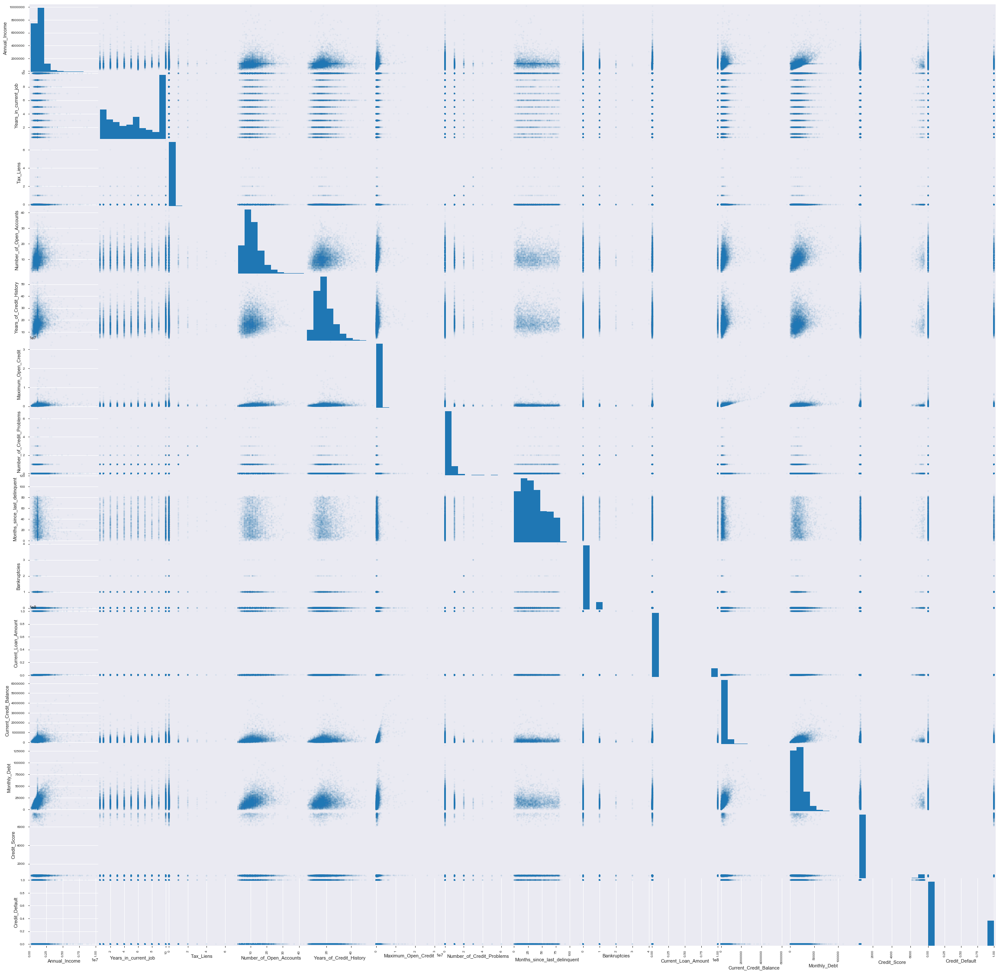

In [78]:
scatter_matrix(df, alpha=0.05, figsize=(40, 40));

In [80]:
NUM_COLUMNS = ['Annual_Income', 'Years_in_current_job', 'Tax_Liens', 'Number_of_Open_Accounts',
               'Years_of_Credit_History', 'Maximum_Open_Credit', 'Number_of_Credit_Problems',
               'Months_since_last_delinquent', 'Bankruptcies', 'Current_Loan_Amount', 'Current_Credit_Balance',
               'Monthly_Debt', 'Credit_Score']
CAT_COLUMNS = ['Home_Ownership', 'Purpose', 'Term']
TARGET_COLUMN = 'Credit_Default'

In [75]:
df.dtypes

Home_Ownership                   object
Annual_Income                   float64
Years_in_current_job            float64
Tax_Liens                       float64
Number_of_Open_Accounts         float64
Years_of_Credit_History         float64
Maximum_Open_Credit             float64
Number_of_Credit_Problems       float64
Months_since_last_delinquent    float64
Bankruptcies                    float64
Purpose                          object
Term                             object
Current_Loan_Amount             float64
Current_Credit_Balance          float64
Monthly_Debt                    float64
Credit_Score                    float64
Credit_Default                    int64
dtype: object

### Обзор данных<a class="anchor" id="review"></a>

**Обзор целевой переменной**

In [81]:
df[TARGET_COLUMN].value_counts()

0    5387
1    2113
Name: Credit_Default, dtype: int64

**Обзор количественных признаков**

In [82]:
df.describe()

,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,Current_Loan_Amount,Current_Credit_Balance,Monthly_Debt,Credit_Score,Credit_Default
count,7.500000e+03,7500.000000,7500.000000,7500.000000,7500.000000,7.500000e+03,7500.000000,3419.000000,7486.000000,7.500000e+03,7.500000e+03,7500.000000,5943.000000,7500.000000
mean,1.325286e+06,5.923800,0.030133,11.130933,18.317467,6.844779e+05,0.170000,34.692600,0.117152,1.187318e+07,2.898332e+05,18314.454133,1151.087498,0.281733
std,7.567551e+05,3.468837,0.271604,4.908924,7.041946,1.112559e+06,0.498598,21.688806,0.347192,3.192612e+07,3.178714e+05,11926.764673,1604.451418,0.449874
min,1.645970e+05,0.500000,0.000000,2.000000,4.000000,0.000000e+00,0.000000,0.000000,0.000000,1.124200e+04,0.000000e+00,0.000000,585.000000,0.000000
25%,9.311330e+05,3.000000,0.000000,8.000000,13.500000,2.792295e+05,0.000000,16.000000,0.000000,1.801690e+05,1.142565e+05,10067.500000,711.000000,0.000000
50%,1.168386e+06,6.000000,0.000000,10.000000,17.000000,4.781590e+05,0.000000,32.000000,0.000000,3.095730e+05,2.093230e+05,16076.500000,731.000000,0.000000
75%,1.499974e+06,10.000000,0.000000,14.000000,21.800000,7.935015e+05,0.000000,50.000000,0.000000,5.198820e+05,3.604062e+05,23818.000000,743.000000,1.000000
max,1.014934e+07,10.000000,7.000000,43.000000,57.700000,3.377440e+07,7.000000,118.000000,4.000000,1.000000e+08,6.506797e+06,136679.000000,7510.000000,1.000000


**Обзор номинативных признаков**

In [83]:
for cat_colname in df.select_dtypes(include='object').columns:
    print(str(cat_colname) + '\n\n' + str(df[cat_colname].value_counts()) + '\n' + '*' * 100 + '\n')

Home_Ownership

Home Mortgage    3649
Rent             3204
Own Home          647
Name: Home_Ownership, dtype: int64
****************************************************************************************************

Purpose

debt consolidation      5944
other                    665
home improvements        412
business loan            129
buy a car                 96
medical bills             71
major purchase            40
take a trip               37
buy house                 34
small business            26
wedding                   15
moving                    11
educational expenses      10
vacation                   8
renewable energy           2
Name: Purpose, dtype: int64
****************************************************************************************************

Term

Short Term    5556
Long Term     1944
Name: Term, dtype: int64
****************************************************************************************************



### Обработка пропусков<a class="anchor" id="gaps"></a>

In [85]:
#медиана для замены пустых значений в колонке 'Months_since_last_delinquent':
median_Months_since_last_delinquent = df['Months_since_last_delinquent'].median()
median_Months_since_last_delinquent

32.0

In [86]:
# (в тестовом тоже заменим пустые на это же значение)

df['Months_since_last_delinquent'] = df['Months_since_last_delinquent'].fillna(median_Months_since_last_delinquent)

In [88]:
# (в тестовом тоже заменим пустые на это же значение)

df['Bankruptcies'] = df['Bankruptcies'].fillna(0)

In [91]:
# (в тестовом тоже заменим пустые на это же значение)

df['Credit_Score'] = df['Credit_Score'].fillna(0)

In [92]:
len(df) - df.count()

Home_Ownership                  0
Annual_Income                   0
Years_in_current_job            0
Tax_Liens                       0
Number_of_Open_Accounts         0
Years_of_Credit_History         0
Maximum_Open_Credit             0
Number_of_Credit_Problems       0
Months_since_last_delinquent    0
Bankruptcies                    0
Purpose                         0
Term                            0
Current_Loan_Amount             0
Current_Credit_Balance          0
Monthly_Debt                    0
Credit_Score                    0
Credit_Default                  0
dtype: int64

In [93]:
df.describe()

,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,Current_Loan_Amount,Current_Credit_Balance,Monthly_Debt,Credit_Score,Credit_Default
count,7.500000e+03,7500.000000,7500.000000,7500.000000,7500.000000,7.500000e+03,7500.000000,7500.000000,7500.000000,7.500000e+03,7.500000e+03,7500.000000,7500.000000,7500.000000
mean,1.325286e+06,5.923800,0.030133,11.130933,18.317467,6.844779e+05,0.170000,33.227467,0.116933,1.187318e+07,2.898332e+05,18314.454133,912.121733,0.281733
std,7.567551e+05,3.468837,0.271604,4.908924,7.041946,1.112559e+06,0.498598,14.703950,0.346904,3.192612e+07,3.178714e+05,11926.764673,1502.588014,0.449874
min,1.645970e+05,0.500000,0.000000,2.000000,4.000000,0.000000e+00,0.000000,0.000000,0.000000,1.124200e+04,0.000000e+00,0.000000,0.000000,0.000000
25%,9.311330e+05,3.000000,0.000000,8.000000,13.500000,2.792295e+05,0.000000,32.000000,0.000000,1.801690e+05,1.142565e+05,10067.500000,667.000000,0.000000
50%,1.168386e+06,6.000000,0.000000,10.000000,17.000000,4.781590e+05,0.000000,32.000000,0.000000,3.095730e+05,2.093230e+05,16076.500000,722.000000,0.000000
75%,1.499974e+06,10.000000,0.000000,14.000000,21.800000,7.935015e+05,0.000000,32.000000,0.000000,5.198820e+05,3.604062e+05,23818.000000,740.000000,1.000000
max,1.014934e+07,10.000000,7.000000,43.000000,57.700000,3.377440e+07,7.000000,118.000000,4.000000,1.000000e+08,6.506797e+06,136679.000000,7510.000000,1.000000


### Обработка выбросов<a class="anchor" id="outliers"></a>

In [109]:
import matplotlib.pyplot as plt
%matplotlib inline

In [128]:
def scat(df,col1,col2):
    plt.figure(figsize=(10, 6))

    plt.scatter(df.loc[df['Credit_Default']==0,col1],
                df.loc[df['Credit_Default']==0,col2],
                alpha=0.75,
                color='blue',
                label='0')

    plt.scatter(df.loc[df['Credit_Default']==1,col1],
                df.loc[df['Credit_Default']==1,col2],
                alpha=0.75,
                color='red',
                label='1')


    plt.xlabel(col1)
    plt.ylabel(col2)
    plt.legend(loc='best');
    

In [137]:
def scat2(df,col1,col2):
    plt.figure(figsize=(10, 6))


    plt.scatter(df.loc[df['Credit_Default']==1,col1],
                df.loc[df['Credit_Default']==1,col2],
                alpha=0.75,
                color='red',
                label='1')

    plt.scatter(df.loc[df['Credit_Default']==0,col1],
                df.loc[df['Credit_Default']==0,col2],
                alpha=0.75,
                color='blue',
                label='0')


    plt.xlabel(col1)
    plt.ylabel(col2)
    plt.legend(loc='best');
    

x=Home_Ownership, y=Annual_Income


x=Home_Ownership, y=Years_in_current_job


x=Home_Ownership, y=Tax_Liens


x=Home_Ownership, y=Number_of_Open_Accounts


x=Home_Ownership, y=Years_of_Credit_History


x=Home_Ownership, y=Maximum_Open_Credit


x=Home_Ownership, y=Number_of_Credit_Problems


x=Home_Ownership, y=Months_since_last_delinquent


x=Home_Ownership, y=Bankruptcies


x=Home_Ownership, y=Purpose


x=Home_Ownership, y=Term


x=Home_Ownership, y=Current_Loan_Amount


x=Home_Ownership, y=Current_Credit_Balance


x=Home_Ownership, y=Monthly_Debt


x=Home_Ownership, y=Credit_Score


x=Home_Ownership, y=Credit_Default


x=Home_Ownership, y=ID


x=Home_Ownership, y=Large_CLA


x=Annual_Income, y=Home_Ownership


x=Annual_Income, y=Years_in_current_job


x=Annual_Income, y=Tax_Liens


x=Annual_Income, y=Number_of_Open_Accounts


x=Annual_Income, y=Years_of_Credit_History




C:\Users\LMAXL\Anaconda3\lib\site-packages\matplotlib\pyplot.py:514: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



x=Annual_Income, y=Maximum_Open_Credit


x=Annual_Income, y=Number_of_Credit_Problems


x=Annual_Income, y=Months_since_last_delinquent


x=Annual_Income, y=Bankruptcies


x=Annual_Income, y=Purpose


x=Annual_Income, y=Term


x=Annual_Income, y=Current_Loan_Amount


x=Annual_Income, y=Current_Credit_Balance


x=Annual_Income, y=Monthly_Debt


x=Annual_Income, y=Credit_Score


x=Annual_Income, y=Credit_Default


x=Annual_Income, y=ID


x=Annual_Income, y=Large_CLA


x=Years_in_current_job, y=Home_Ownership


x=Years_in_current_job, y=Annual_Income


x=Years_in_current_job, y=Tax_Liens


x=Years_in_current_job, y=Number_of_Open_Accounts


x=Years_in_current_job, y=Years_of_Credit_History


x=Years_in_current_job, y=Maximum_Open_Credit


x=Years_in_current_job, y=Number_of_Credit_Problems


x=Years_in_current_job, y=Months_since_last_delinquent


x=Years_in_current_job, y=Bankruptcies


x=Years_in_current_job, y=Purpose


x=Years_in_current_job, y=Term


x=Years_in_current_job, y=Current

x=Current_Loan_Amount, y=Current_Credit_Balance


x=Current_Loan_Amount, y=Monthly_Debt


x=Current_Loan_Amount, y=Credit_Score


x=Current_Loan_Amount, y=Credit_Default


x=Current_Loan_Amount, y=ID


x=Current_Loan_Amount, y=Large_CLA


x=Current_Credit_Balance, y=Home_Ownership


x=Current_Credit_Balance, y=Annual_Income


x=Current_Credit_Balance, y=Years_in_current_job


x=Current_Credit_Balance, y=Tax_Liens


x=Current_Credit_Balance, y=Number_of_Open_Accounts


x=Current_Credit_Balance, y=Years_of_Credit_History


x=Current_Credit_Balance, y=Maximum_Open_Credit


x=Current_Credit_Balance, y=Number_of_Credit_Problems


x=Current_Credit_Balance, y=Months_since_last_delinquent


x=Current_Credit_Balance, y=Bankruptcies


x=Current_Credit_Balance, y=Purpose


x=Current_Credit_Balance, y=Term


x=Current_Credit_Balance, y=Current_Loan_Amount


x=Current_Credit_Balance, y=Monthly_Debt


x=Current_Credit_Balance, y=Credit_Score


x=Current_Credit_Balance, y=Credit_Default


x=Current_C

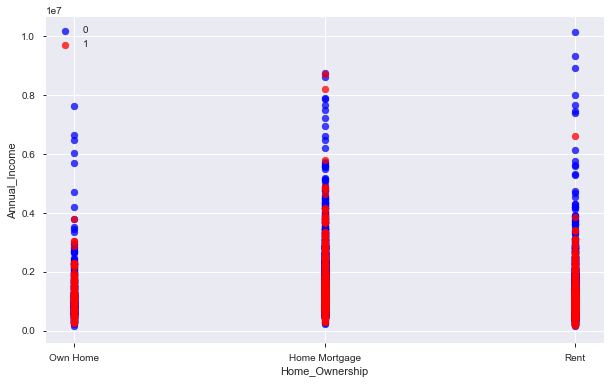

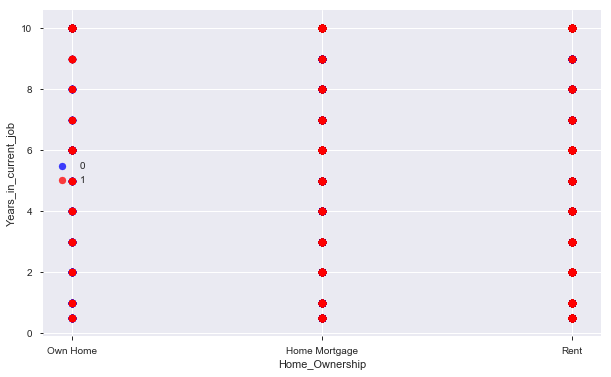

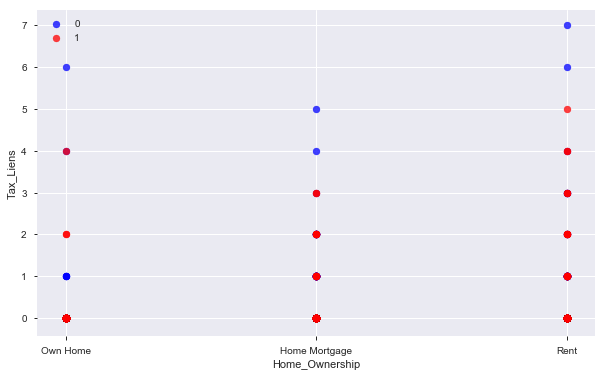

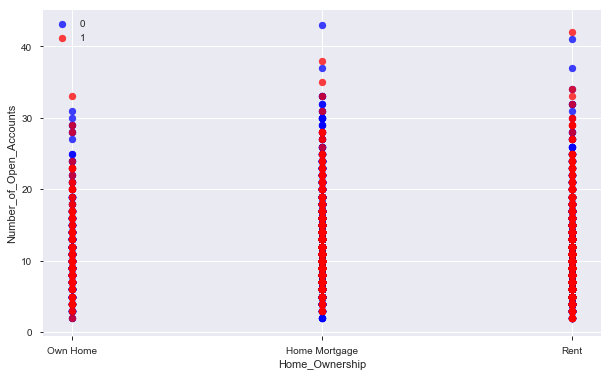

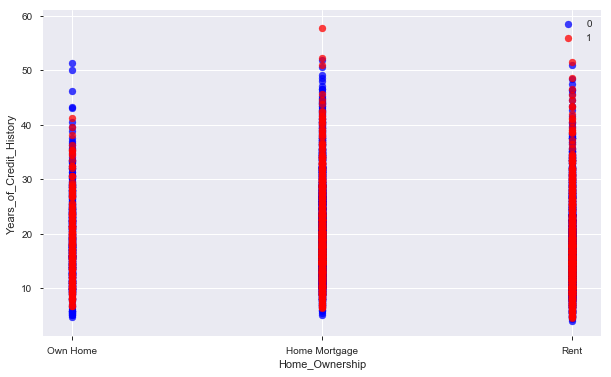

...

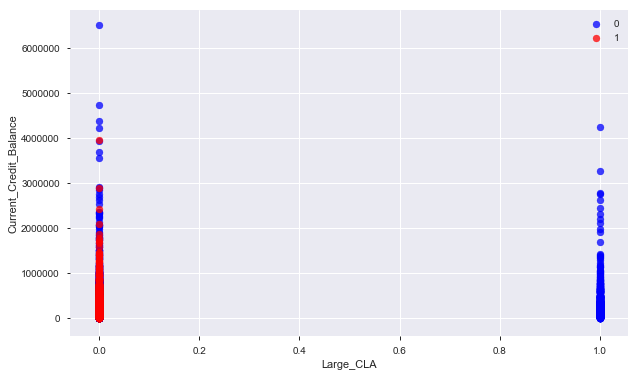

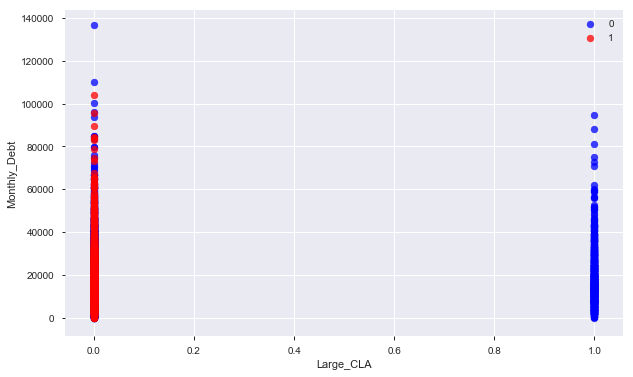

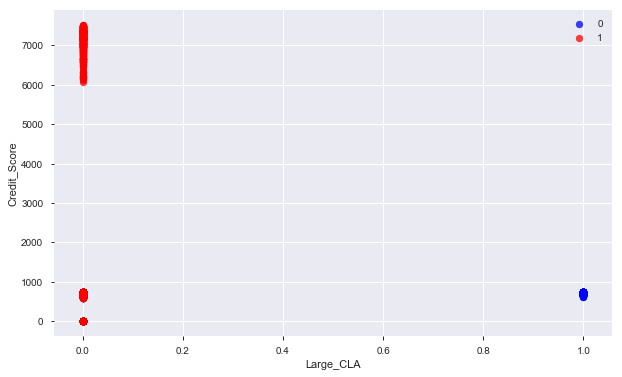

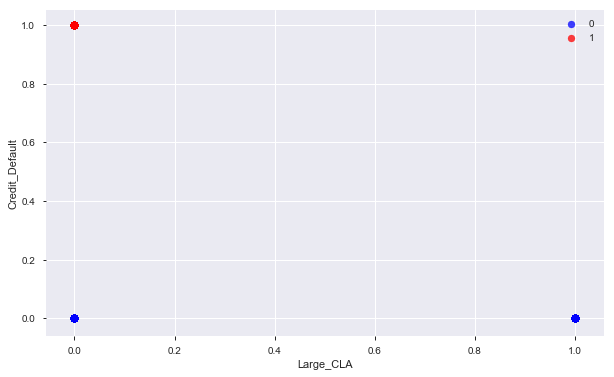

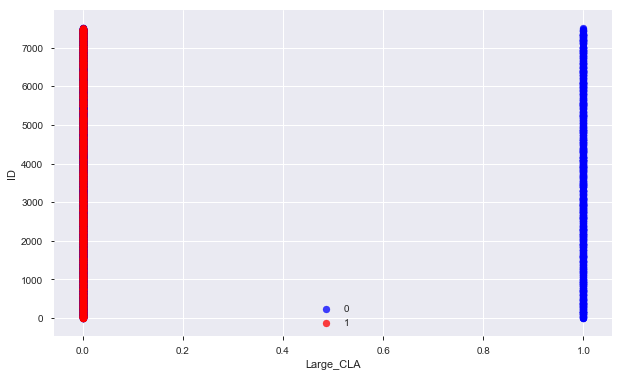

In [136]:
for col1 in df.columns:
    for col2 in df.columns:
        if col1 != col2:
#             print (f'x={col1}, y={col2}\n\n')
            scat(df,col1, col2)

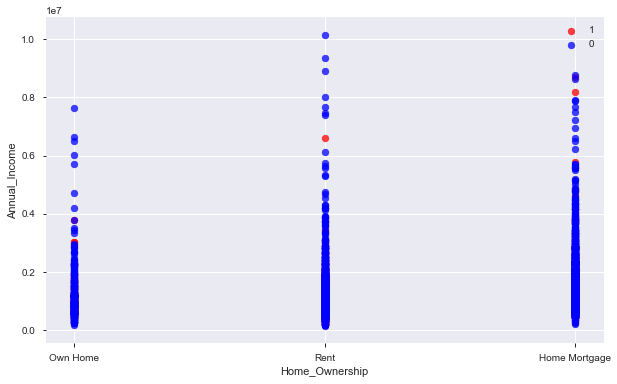

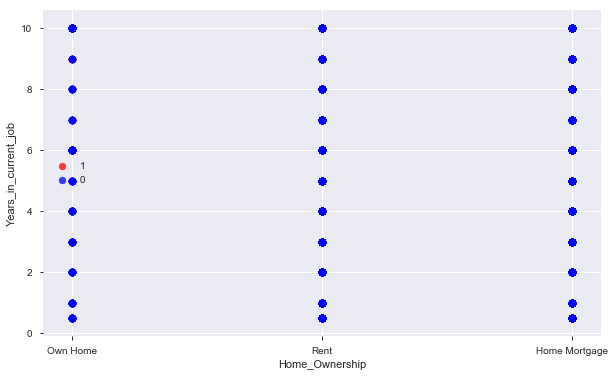

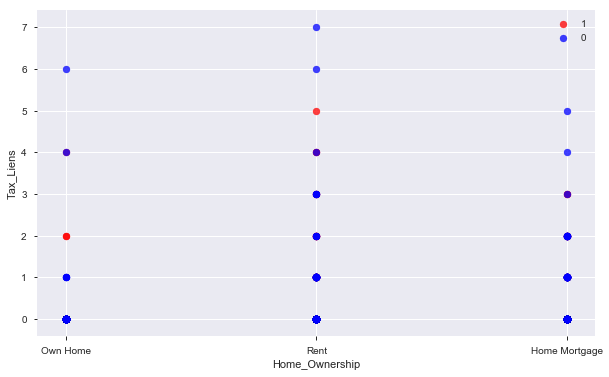

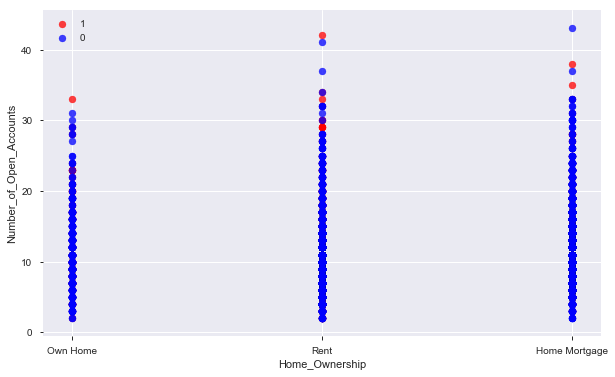

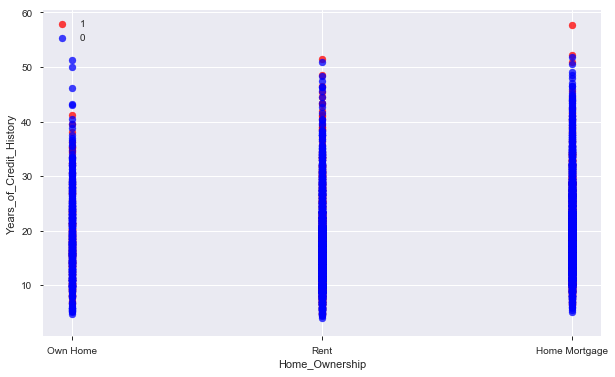

...

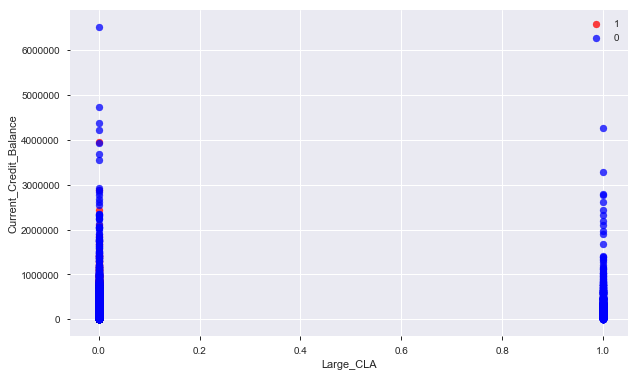

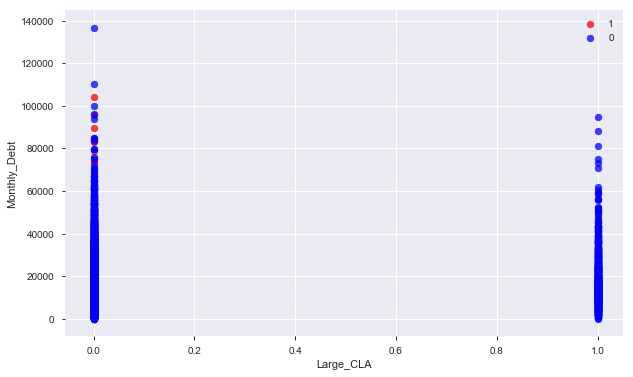

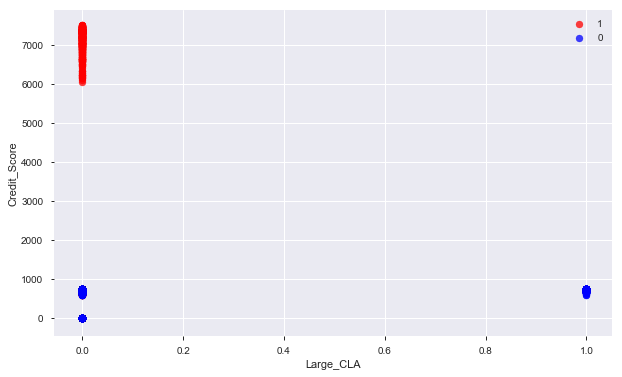

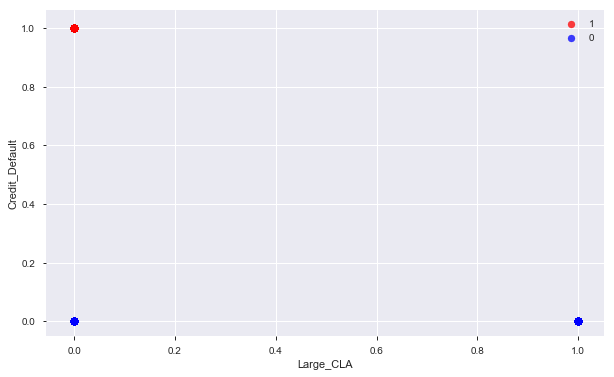

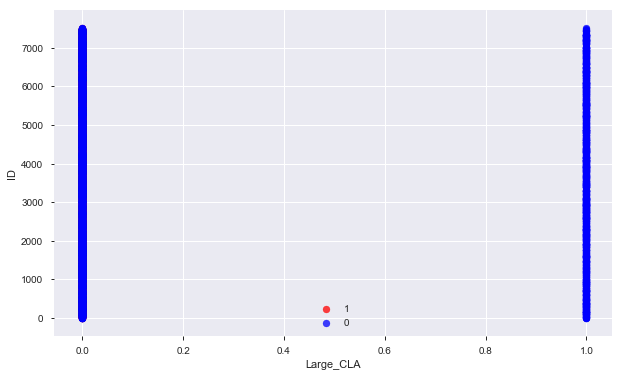

In [138]:
for col1 in df.columns:
    for col2 in df.columns:
        if col1 != col2:
            scat2(df,col1, col2)

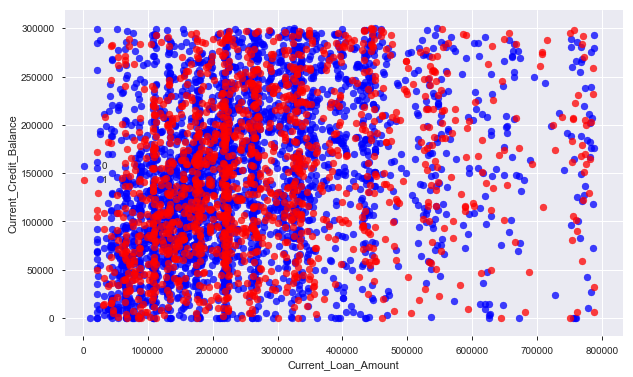

In [117]:
col1 = 'Current_Loan_Amount'
col2 = 'Current_Credit_Balance'

plt.figure(figsize=(10, 6))


plt.scatter(df.loc[(df['Current_Loan_Amount']<2000000)&(df['Credit_Default']==0)&(df['Current_Credit_Balance']<300000),'Current_Loan_Amount'],
            df.loc[(df['Current_Loan_Amount']<2000000)&(df['Credit_Default']==0)&(df['Current_Credit_Balance']<300000),'Current_Credit_Balance'],
            alpha=0.75,
            color='blue',
            label='0')

plt.scatter(df.loc[(df['Current_Loan_Amount']<2000000)&(df['Credit_Default']==1)&(df['Current_Credit_Balance']<300000),'Current_Loan_Amount'],
            df.loc[(df['Current_Loan_Amount']<2000000)&(df['Credit_Default']==1)&(df['Current_Credit_Balance']<300000),'Current_Credit_Balance'],
            alpha=0.75,
            color='red',
            label='1')


plt.xlabel(col1)
plt.ylabel(col2)
plt.legend(loc='best');

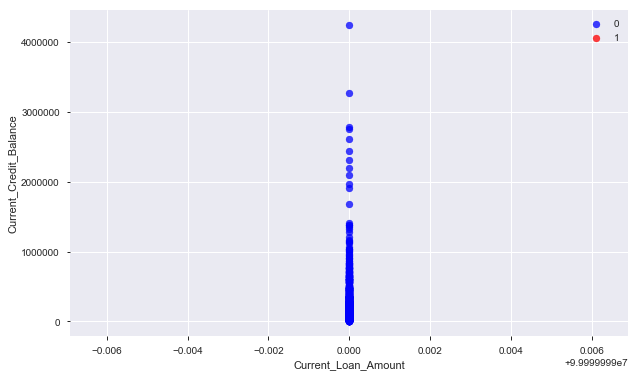

In [121]:
col1 = 'Current_Loan_Amount'
col2 = 'Current_Credit_Balance'

plt.figure(figsize=(10, 6))


plt.scatter(df.loc[(df['Current_Loan_Amount']>=2000000)&(df['Credit_Default']==0),'Current_Loan_Amount'],
            df.loc[(df['Current_Loan_Amount']>=2000000)&(df['Credit_Default']==0),'Current_Credit_Balance'],
            alpha=0.75,
            color='blue',
            label='0')

plt.scatter(df.loc[(df['Current_Loan_Amount']>=2000000)&(df['Credit_Default']==1),'Current_Loan_Amount'],
            df.loc[(df['Current_Loan_Amount']>=2000000)&(df['Credit_Default']==1),'Current_Credit_Balance'],
            alpha=0.75,
            color='red',
            label='1')


plt.xlabel(col1)
plt.ylabel(col2)
plt.legend(loc='best');

### Построение новых признаков<a class="anchor" id="new_features"></a>

**Id**

In [94]:
df['ID'] = df.index.tolist()

In [126]:
df.loc[df['Current_Loan_Amount']>=2000000, 'Large_CLA'] = 1
df['Large_CLA'] = df['Large_CLA'].fillna(0).astype(int)

In [141]:
df.loc[df['Credit_Score']>=5000, 'Large_CScore'] = 1
df['Large_CScore'] = df['Large_CScore'].fillna(0).astype(int)

**Dummies**

In [95]:
df['Term'] = df['Term'].map({'Long Term':'1', 'Short Term':'0'}).astype(int)

In [102]:
df.loc[(df['Purpose'] == 'home improvements')|(df['Purpose'] == 'major purchase')|(df['Purpose'] == 'take a trip')|(df['Purpose'] =='wedding')|(df['Purpose'] =='moving')|(df['Purpose'] =='vacation')|(df['Purpose'] =='renewable energy')|(df['Purpose'] =='buy a car'), 'Purpose'] = 'consumption'


In [106]:
df.loc[(df['Purpose'] == 'business loan')|(df['Purpose'] == 'small business'), 'Purpose'] = 'business'

In [107]:
df['Purpose'].value_counts()

debt consolidation      5944
other                    665
consumption              621
business                 155
medical bills             71
buy house                 34
educational expenses      10
Name: Purpose, dtype: int64

In [143]:
df.dtypes

Home_Ownership                   object
Annual_Income                   float64
Years_in_current_job            float64
Tax_Liens                       float64
Number_of_Open_Accounts         float64
Years_of_Credit_History         float64
Maximum_Open_Credit             float64
Number_of_Credit_Problems       float64
Months_since_last_delinquent    float64
Bankruptcies                    float64
Purpose                          object
Term                              int32
Current_Loan_Amount             float64
Current_Credit_Balance          float64
Monthly_Debt                    float64
Credit_Score                      int32
Credit_Default                    int64
ID                                int64
Large_CLA                         int32
Large_CScore                      int32
dtype: object

In [144]:
for cat_colname in df.select_dtypes(include='object').columns[1:]:
    df = pd.concat([df, pd.get_dummies(df[cat_colname], prefix=cat_colname)], axis=1)

In [146]:
df = pd.concat([df, pd.get_dummies(df['Home_Ownership'], prefix='Home_Ownership')], axis=1)

In [147]:
df.head(10)

,Home_Ownership,Annual_Income,Years_in_current_job,Tax_Liens,Number_of_Open_Accounts,Years_of_Credit_History,Maximum_Open_Credit,Number_of_Credit_Problems,Months_since_last_delinquent,Bankruptcies,...,Purpose_business,Purpose_buy house,Purpose_consumption,Purpose_debt consolidation,Purpose_educational expenses,Purpose_medical bills,Purpose_other,Home_Ownership_Home Mortgage,Home_Ownership_Own Home,Home_Ownership_Rent
0,Own Home,482087.0,6.0,0.0,11.0,26.3,685960.0,1.0,32.0,1.0,...,0,0,0,1,0,0,0,0,1,0
1,Own Home,1025487.0,10.0,0.0,15.0,15.3,1181730.0,0.0,32.0,0.0,...,0,0,0,1,0,0,0,0,1,0
2,Home Mortgage,751412.0,8.0,0.0,11.0,35.0,1182434.0,0.0,32.0,0.0,...,0,0,0,1,0,0,0,1,0,0
3,Own Home,805068.0,6.0,0.0,8.0,22.5,147400.0,1.0,32.0,1.0,...,0,0,0,1,0,0,0,0,1,0
4,Rent,776264.0,8.0,0.0,13.0,13.6,385836.0,1.0,32.0,0.0,...,0,0,0,1,0,0,0,0,0,1
5,Rent,1168386.0,7.0,0.0,12.0,14.6,366784.0,0.0,32.0,0.0,...,0,0,0,0,0,0,1,0,0,1
6,Home Mortgage,1511108.0,10.0,0.0,9.0,20.3,388124.0,0.0,73.0,0.0,...,0,0,1,0,0,0,0,1,0,0
7,Rent,1040060.0,10.0,0.0,13.0,12.0,330374.0,0.0,18.0,0.0,...,0,0,0,0,0,0,1,0,0,1
8,Home Mortgage,1168386.0,5.0,0.0,17.0,15.7,0.0,1.0,32.0,1.0,...,0,0,1,0,0,0,0,1,0,0
9,Home Mortgage,1168386.0,1.0,0.0,10.0,24.6,511302.0,0.0,6.0,0.0,...,0,0,0,1,0,0,0,1,0,0


### Сохранение обучающего датасета<a class="anchor" id="saving"></a>

In [148]:
df.to_csv(PREP_DATASET_PATH, index=False, encoding='utf-8')

In [149]:
pandas_profiling.ProfileReport(df)

In [151]:
import pandas as pd
import numpy as np
import pickle
import random

from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split, ShuffleSplit, cross_val_score, learning_curve
from sklearn.model_selection import KFold, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import classification_report, f1_score, precision_score, recall_score

from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb, lightgbm as lgbm, catboost as catb

import seaborn as sns
from matplotlib import pyplot as plt
%matplotlib inline

In [152]:
import warnings
# warnings.simplefilter('ignore')

In [153]:
def get_classification_report(y_train_true, y_train_pred, y_test_true, y_test_pred):
    print('TRAIN\n\n' + classification_report(y_train_true, y_train_pred))
    print('TEST\n\n' + classification_report(y_test_true, y_test_pred))
    print('CONFUSION MATRIX\n')
    print(pd.crosstab(y_test_true, y_test_pred))

In [154]:
def balance_df_by_target(df, target_name):

    target_counts = df[target_name].value_counts()

    major_class_name = target_counts.argmax()
    minor_class_name = target_counts.argmin()

    disbalance_coeff = int(target_counts[major_class_name] / target_counts[minor_class_name]) - 1

    for i in range(disbalance_coeff):
        sample = df[df[target_name] == minor_class_name].sample(target_counts[minor_class_name])
        df = df.append(sample, ignore_index=True)

    return df.sample(frac=1) 